In [ ]:
# Convenient jupyter setup
%load_ext autoreload
%autoreload 2

In [3]:
import geopandas as gpd
import shapely
import shapely.geometry
import pandas as pd

import matplotlib.pyplot as plt
import numpy as np

from src.utils.os import list_content
from src.constants import WGS84, JRC_PATH, GEDI_L1B_PATH, GEDI_L2A_PATH
from src.data.gedi_granule import GediGranule, GediBeam

print(GEDI_L1B_PATH)

/gws/nopw/j04/forecol/data/GEDI/level1B


In [4]:
gedi_granules = list_content(GEDI_L1B_PATH / "v002" / "example", glob_query="*/*.h5")
gedi_granules_2a = list_content(GEDI_L2A_PATH / "v002" / "example", glob_query="*/*.h5")
print(f"There are {len(gedi_granules)} granules for the region of interest")

There are 23 granules for the region of interest


In [5]:
granule = GediGranule(gedi_granules[0])
granule

GEDI Granule:
 Granule name: GEDI01_B_2019116060412_O02087_T03318_02_005_01_seg1.h5
 Product:      GEDI_L1B
 No. beams:    8
 HDF object:   <HDF5 file "GEDI01_B_2019116060412_O02087_T03318_02_005_01_seg1.h5" (mode r)>

In [6]:
granule_2a = GediGranule(gedi_granules_2a[0])
granule_2a

GEDI Granule:
 Granule name: GEDI02_A_2019116060412_O02087_01_T03318_02_003_01_V002.h5
 Sub-granule:  01
 Product:      GEDI_L2A
 Release:      V002
 No. beams:    8
 Start date:   2019-04-26
 Start time:   06:04:12
 HDF object:   <HDF5 file "GEDI02_A_2019116060412_O02087_01_T03318_02_003_01_V002.h5" (mode r)>

GEDI02_A_2019116060412_O02087_01_T03318_02_003_01_V002.h5

In [7]:
list(granule)

['BEAM0000',
 'BEAM0001',
 'BEAM0010',
 'BEAM0011',
 'BEAM0101',
 'BEAM0110',
 'BEAM1000',
 'BEAM1011',
 'METADATA']

In [8]:
beam = granule.beam(0)
beam

GEDI Beam object:
 Beam name:  BEAM0000
 Beam type:  Coverage beam
 Shots:      494
 HDF object: <HDF5 group "BEAM0000" (39 members)>

For relevant L1B (v002) data see [here](https://lpdaac.usgs.gov/resources/e-learning/getting-started-gedi-l1b-version-2-data-python/)

In [12]:
save_path = GEDI_L1B_PATH  / "v002" / "example" / "all_shots_v0.gpkg"
overwrite = False

if not save_path.exists() or overwrite:
    print("Extracting all shots")
    import tqdm
    datas = []
    for granule_path in tqdm.tqdm(gedi_granules):
        granule = GediGranule(granule_path)
        for beam in granule.iter_beams():
            datas.append(beam.main_data)
    all_shots = pd.concat(datas).reset_index(drop=True)
    all_shots.to_file(save_path, driver="GPKG")
    
else:
    print("Loading from file")
    all_shots = gpd.read_file(save_path)

Loading from file


Let's extract one waveform

In [11]:
all_shots

,granule_name,shot_number,beam_type,beam_name,delta_time,degrade,stale_return_flag,solar_elevation,solar_azimuth,rx_energy,...,elevation_bin0_error,latitude_lastbin,latitude_lastbin_error,longitude_lastbin,longitude_lastbin_error,elevation_lastbin,elevation_lastbin_error,waveform_start,waveform_count,geometry
0,GEDI01_B_2019116060412_O02087_T03318_02_005_01...,20870000100082336,coverage,BEAM0000,4.149511e+07,0,1,-49.036575,-49.036575,1239.1250,...,0.283469,-5.849302,0.000045,-55.677014,0.000033,3854.869948,0.283480,0,1270,POINT (-55.67701 -5.84930)
1,GEDI01_B_2019116060412_O02087_T03318_02_005_01...,20870000100082337,coverage,BEAM0000,4.149511e+07,0,1,-49.036148,-49.036148,334.8125,...,0.283467,-5.848896,0.000045,-55.676710,0.000033,3940.223539,0.283473,1270,701,POINT (-55.67671 -5.84890)
2,GEDI01_B_2019116060412_O02087_T03318_02_005_01...,20870000100082338,coverage,BEAM0000,4.149511e+07,0,1,-49.035725,-49.035725,653.8750,...,0.283465,-5.848465,0.000045,-55.676412,0.000033,3876.430082,0.283475,1971,1126,POINT (-55.67641 -5.84846)
3,GEDI01_B_2019116060412_O02087_T03318_02_005_01...,20870000100082339,coverage,BEAM0000,4.149511e+07,0,1,-49.035301,-49.035301,2824.3125,...,0.283463,-5.848045,0.000045,-55.676111,0.000033,3883.235823,0.283473,3097,1081,POINT (-55.67611 -5.84805)
4,GEDI01_B_2019116060412_O02087_T03318_02_005_01...,20870000100082340,coverage,BEAM0000,4.149511e+07,0,1,-49.034874,-49.034874,1739.0000,...,0.283462,-5.847629,0.000045,-55.675809,0.000033,3908.287013,0.283469,4178,912,POINT (-55.67581 -5.84763)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
236157,GEDI01_B_2019288094931_O04759_T03165_02_005_01...,47591100100081550,full,BEAM1011,5.636944e+07,0,1,11.064566,11.064566,156.5625,...,0.420307,-5.360619,0.000047,-55.529474,0.000035,2487.233480,0.420382,857928,701,POINT (-55.52947 -5.36062)
236158,GEDI01_B_2019288094931_O04759_T03165_02_005_01...,47591100100081551,full,BEAM1011,5.636944e+07,0,1,11.064839,11.064839,498.3750,...,0.420333,-5.360199,0.000047,-55.529174,0.000035,2486.653526,0.420407,858629,701,POINT (-55.52917 -5.36020)
236159,GEDI01_B_2019288094931_O04759_T03165_02_005_01...,47591100100081552,full,BEAM1011,5.636944e+07,0,1,11.065113,11.065113,91.6875,...,0.420354,-5.359780,0.000047,-55.528875,0.000035,2487.135526,0.420429,859330,701,POINT (-55.52887 -5.35978)
236160,GEDI01_B_2019288094931_O04759_T03165_02_005_01...,47591100100081553,full,BEAM1011,5.636944e+07,0,1,11.065386,11.065386,-28.3750,...,0.420372,-5.359361,0.000047,-55.528575,0.000035,2486.796774,0.420447,860031,701,POINT (-55.52857 -5.35936)


## 1. Getting the waveform of the shot

In [11]:
granule = GediGranule(gedi_granules[1])
beam = granule.beam(5)

In [12]:
shots = beam["shot_number"]
dem_srtm = beam["geolocation/digital_elevation_model_srtm"][:]
dem_tandemx = beam["geolocation/digital_elevation_model"][:]
waveform_start = beam["rx_sample_start_index"][:] - 1
waveform_count = beam["rx_sample_count"][:]

elevation_bin0s = beam["geolocation/elevation_bin0"][:]
elevation_lastbins = beam["geolocation/elevation_lastbin"][:]
elevation_increments = (elevation_bin0s - elevation_lastbins) / waveform_count

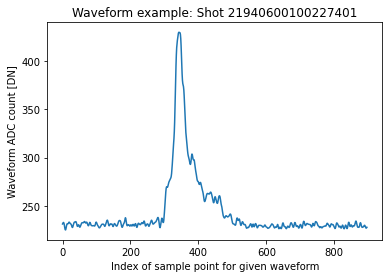

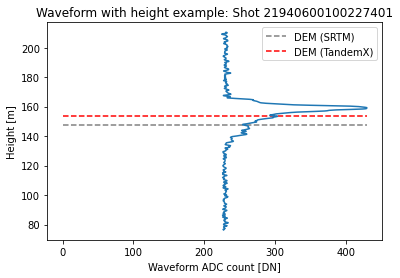

In [13]:
sample = 0

# waveform of the first shot for this beam in this sub-granule
waveform0 = beam["rxwaveform"][
    waveform_start[sample] : waveform_start[sample] + waveform_count[sample]
]
waveform_elevation = elevation_lastbins[sample] + elevation_increments[
    sample
] * np.arange(waveform_count[sample], 0, -1)

# Plot waveform
plt.plot(waveform0)
plt.xlabel("Index of sample point for given waveform")
plt.ylabel("Waveform ADC count [DN]")
plt.title(f"Waveform example: Shot {shots[sample]}")
plt.show()

# Calculate elevation
elevation_bin0s = beam["geolocation/elevation_bin0"][:]
elevation_lastbins = beam["geolocation/elevation_lastbin"][:]
elevation_increments = (elevation_bin0s - elevation_lastbins) / waveform_count

waveform_elevation = elevation_lastbins[sample] + elevation_increments[
    sample
] * np.arange(waveform_count[sample], 0, -1)

# Plot
plt.plot(waveform0, waveform_elevation)
plt.title(f"Waveform with height example: Shot {shots[sample]}")
plt.hlines(
    dem_srtm[sample],
    0,
    max(waveform0),
    color="grey",
    linestyles="dashed",
    label="DEM (SRTM)",
)
plt.hlines(
    dem_tandemx[sample],
    0,
    max(waveform0),
    color="red",
    linestyles="dashed",
    label="DEM (TandemX)",
)
plt.xlabel("Waveform ADC count [DN]")
plt.ylabel("Height [m]")
plt.legend()
plt.show()

Next, let's transform this waveform return data as 

## 2. Getting the time of the shot

In [14]:
import pandas as pd

GPS_EPOCH = pd.to_datetime("1980-01-06T00:00:00Z")
GEDI_MASTER_TIME_EPOCH = (
    GPS_EPOCH
    + pd.to_timedelta(list(beam["ancillary/master_time_epoch"])[0], unit="seconds")
    + pd.to_timedelta(list(beam["delta_time"]), unit="seconds")
)
GEDI_MASTER_TIME_EPOCH + pd.to_timedelta(list(beam["delta_time"]), unit="seconds")

DatetimeIndex(['2020-09-01 07:25:25.540460796+00:00',
               '2020-09-01 07:25:25.556988806+00:00',
               '2020-09-01 07:25:25.573516800+00:00',
               '2020-09-01 07:25:25.590044796+00:00',
               '2020-09-01 07:25:25.606574804+00:00',
               '2020-09-01 07:25:25.623106792+00:00',
               '2020-09-01 07:25:25.639638796+00:00',
               '2020-09-01 07:25:25.656170800+00:00',
               '2020-09-01 07:25:25.672702804+00:00',
               '2020-09-01 07:25:25.689234794+00:00',
               ...
               '2020-09-01 07:25:52.631408096+00:00',
               '2020-09-01 07:25:52.647936106+00:00',
               '2020-09-01 07:25:52.664464102+00:00',
               '2020-09-01 07:25:52.680992096+00:00',
               '2020-09-01 07:25:52.697520108+00:00',
               '2020-09-01 07:25:52.714048102+00:00',
               '2020-09-01 07:25:52.730576098+00:00',
               '2020-09-01 07:25:52.747104094+00:00',
         

## 3. Getting waveform transects

In [ ]:
import warnings
import holoviews as hv
from holoviews import opts
hv.extension("bokeh", "matplotlib")
warnings.filterwarnings("ignore")

In [153]:
granule = GediGranule(gedi_granules[15])
beam = granule.beam(0)
beam

GEDI Beam object:
 Beam name:  BEAM0000
 Beam type:  Coverage beam
 Shots:      697
 HDF object: <HDF5 group "BEAM0000" (39 members)>

In [ ]:
shots = beam["shot_number"]
dem_srtm = beam["geolocation/digital_elevation_model_srtm"][:]
dem_tandemx = beam["geolocation/digital_elevation_model"][:]
waveform_start = beam["rx_sample_start_index"][:] - 1
waveform_count = beam["rx_sample_count"][:]

elevation_bin0s = beam["geolocation/elevation_bin0"][:]
elevation_lastbins = beam["geolocation/elevation_lastbin"][:]
elevation_increments = (elevation_bin0s - elevation_lastbins) / waveform_count

In [154]:
start_shot_index = 0
end_shot_index = 100
# Calculate along-track distance
distance = np.arange(
    0.0, (end_shot_index - start_shot_index) * 60.0, 60.0
)  # GEDI Shots are spaced 60 m apart

In [155]:
distance_elevation_amplitude = []
for shot_index in range(start_shot_index, end_shot_index):
    # quality filtering:
    if (
        beam["geolocation/degrade"][shot_index] == 0
        and beam["stale_return_flag"][shot_index] == 0
    ):
        # Get waveform elevation
        waveform_elevation = elevation_lastbins[shot_index] + elevation_increments[
            shot_index
        ] * np.arange(waveform_count[shot_index], 0, -1)
        # Get waveform digital number
        waveform_amplitude = beam["rxwaveform"][
            waveform_start[sample] : waveform_start[sample] + waveform_count[sample]
        ]

        waves = []
        for elevation, amplitude in zip(waveform_elevation, waveform_amplitude):
            waves.append(
                (distance[shot_index], elevation, amplitude)
            )  # Append Distance (x), waveform elevation (y) and waveform amplitude (z)
        distance_elevation_amplitude.append(waves)
    else:
        print(
            f"Shot {shot_index} ({beam['shot_number'][shot_index]}) did not pass the quality filtering."
        )

In [156]:
# Create along track visualizations of the waveforms and compare to DEM
along_track_vis = hv.Path(distance_elevation_amplitude, vdims="Amplitude")
dem_srtm_vis = hv.Curve(
    (distance, dem_srtm[:end_shot_index]),
    label="DEM SRTM",
    kdims="distance",
    vdims="srtm-elevation",
)
dem_tandemx_vis = hv.Curve(
    (distance, dem_tandemx[:end_shot_index]),
    label="DEM TandemX",
    kdims="distance",
    vdims="tandemx-elevation",
);

In [157]:
# Visualise:
print(
    f"Showing data for shots {start_shot_index} to {end_shot_index} of beam {beam.name} ({beam.beam_type}) of subgranule {beam.parent_granule.filename}"
)
(along_track_vis * dem_srtm_vis * dem_tandemx_vis).options(
    opts.Curve(tools=["hover"], width=800, line_dash="dotted"),
    opts.Path(
        color="Amplitude",
        clim=(200, 405),
        cmap="Greens",
        line_width=5,
        width=950,
        height=500,
        clabel="Amplitude",
        colorbar=True,
        xlabel="Distance Along Transect (m)",
        ylabel="Elevation (m)",
        fontsize={
            "title": 16,
            "xlabel": 16,
            "ylabel": 16,
            "xticks": 12,
            "yticks": 12,
            "clabel": 12,
            "cticks": 10,
        },
        colorbar_position="right",
        title=f"GEDI L1B Waveforms ({beam.name})",
    )
)

Showing data for shots 0 to 100 of beam BEAM0000 (coverage) of subgranule GEDI01_B_2019224110837_O03767_T00472_02_005_01_seg1.h5


:Overlay
   .Path.I            :Path   [x,y]   (Amplitude)
   .Curve.DEM_SRTM    :Curve   [distance]   (srtm-elevation)
   .Curve.DEM_TandemX :Curve   [distance]   (tandemx-elevation)

# Legacy: The GEDI way

In [160]:
import h5py

gediL1B = GediGranule(gedi_granules[1])
beamNames = ['BEAM0000']
shot = 21940000100080987

index = np.where(gediL1B[f'{beamNames[0]}/shot_number'][()]==shot)[0][0]  # Set the index for the shot identified above
print(index)

gediL1B_objs = []
gediL1B.visit(gediL1B_objs.append)                                           # Retrieve list of datasets
gediSDS = [o for o in gediL1B_objs if isinstance(gediL1B[o], h5py.Dataset)]

# From the SDS list, use list comprehension to find sample_count, sample_start_index, and rxwaveform
sdsCount = gediL1B[[g for g in gediSDS if g.endswith('/rx_sample_count') and beamNames[0] in g][0]]
sdsStart = gediL1B[[g for g in gediSDS if g.endswith('/rx_sample_start_index') and beamNames[0] in g][0]]
sdsWaveform = [g for g in gediSDS if g.endswith('/rxwaveform') and beamNames[0] in g][0]

wfCount = sdsCount[index]           # Number of samples in the waveform
wfStart = int(sdsStart[index] - 1)  # Subtract one because python array indexing starts at 0 not 1
waveform = gediL1B[sdsWaveform][wfStart: wfStart + wfCount]

# Grab the elevation recorded at the start and end of the full waveform capture
zStart = gediL1B[f'{beamNames[0]}/geolocation/elevation_bin0'][index]   # Height of the start of the rx window
zEnd = gediL1B[f'{beamNames[0]}/geolocation/elevation_lastbin'][index]  # Height of the end of the rx window

zStretch = np.add(zEnd, np.multiply(range(wfCount, 0, -1), ((zStart - zEnd) / int(wfCount))))

0


In [161]:
np.allclose(zStretch, waveform_elevation)

ValueError: operands could not be broadcast together with shapes (893,) (746,) 

In [162]:
index = 50
# Grab 50 points before and after the shot visualized above
start = index - 50
end = index + 50 
transectIndex = np.arange(start, end, 1)

# Calculate along-track distance
distance = np.arange(0.0, len(transectIndex) * 60, 60)  # GEDI Shots are spaced 60 m apart

In [163]:
# Create a list of tuples containing Shot number, and each waveform value at height (z)
wfList = []
for s, i in enumerate(transectIndex):
    # Basic quality filtering from section 5
    if gediL1B['BEAM0110/geolocation/degrade'][i] == 0 and gediL1B['BEAM0110/stale_return_flag'][i] == 0:
        zStart = gediL1B['BEAM0110/geolocation/elevation_bin0'][i]
        zEnd = gediL1B['BEAM0110/geolocation/elevation_lastbin'][i]
        zCount = sdsCount[i]
        zStretch = np.add(zEnd, np.multiply(range(zCount, 0, -1), ((zStart - zEnd) / int(zCount))))
        waveform = gediL1B[sdsWaveform][sdsStart[i]: sdsStart[i] + zCount]
        waves = []
        for z, w in enumerate(waveform):
            waves.append((distance[s], zStretch[z],w))  # Append Distance (x), waveform elevation (y) and waveform amplitude (z)
        wfList.append(waves)
    else:
        print(f"Shot {s} did not pass quality filtering and will be excluded.")

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
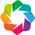

:Path   [x,y]   (Amplitude)

In [164]:
import warnings
import holoviews as hv
hv.extension('bokeh', 'matplotlib')
warnings.filterwarnings('ignore')
# Plot the waveform values for the transect with the waveform amplitude being plotted as the 'c' or colormap
l1bVis = hv.Path(wfList, vdims='Amplitude').options(color='Amplitude', clim=(200,405), cmap='Greens', line_width=20, width=950,
                                                    height=500, clabel='Amplitude',colorbar=True, 
                                                    xlabel='Distance Along Transect (m)', ylabel='Elevation (m)', 
                                                    fontsize={'title':16, 'xlabel':16, 'ylabel': 16, 'xticks':12, 'yticks':12, 
                                                              'clabel':12, 'cticks':10}, colorbar_position='right',
                                                    title='GEDI L1B Waveforms')
l1bVis